# Overview

- __DATA DESCRIPTION__
- __IMPORTING LIBRARIES__
- __EDA__
- __PREPROESSING__
- __CLUSTERNING__
- __MODEL SELECTION__
- __TUNING__

In [ ]:
Note : Certain plots are blank as they are plo

# Data Description

Here, important aspects of the data are discussed refrenced from the journal paper

- The aim is to build a regression model that predicts the number of comments a post is expected to receive in the next H hours, which is a feature of the column (Index 38).
- A base time is selected randomly for scrapping, for simulating the scenario (Index 34)(0-72)
- Only those comments published in the last 72 hours, w.r.t the basetime are selected. As, the older posts are found to gain less attention and hence less comments
- The file comes in form of batches, each batch taken at a different time.

# Importing the essential libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os 
#import sweetviz

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
from scipy.stats import relfreq

In [3]:
plt.style.use('fivethirtyeight')

In [4]:
data = pd.read_csv('Combined_training_data/input_file.csv')

In [6]:
data.head() # columns of the dataset

,pg_likes,pg_checkins,people_returns_pg,pg_category,c1_min,c1_max,c1_avg,c1_median,c1_std_dev,c2_min,...,post_pub_fri,post_pub_sat,base_sun,base_mon,base_tue,base_wed,base_thu,base_fri,base_sat,comments_received
0,634995.0,0.0,463.0,1.0,0.0,806.0,11.291,1.0,70.4951,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,634995.0,0.0,463.0,1.0,0.0,806.0,11.291,1.0,70.4951,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,634995.0,0.0,463.0,1.0,0.0,806.0,11.291,1.0,70.4951,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,634995.0,0.0,463.0,1.0,0.0,806.0,11.291,1.0,70.4951,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,634995.0,0.0,463.0,1.0,0.0,806.0,11.291,1.0,70.4951,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [7]:
print('shape of the dataset {}'.format(data.shape))

shape of the dataset (602813, 54)


In [8]:
data.dtypes

pg_likes                 float64
pg_checkins              float64
people_returns_pg        float64
pg_category              float64
c1_min                   float64
c1_max                   float64
c1_avg                   float64
c1_median                float64
c1_std_dev               float64
c2_min                   float64
c2_max                   float64
c2_avg                   float64
c2_median                float64
c2_std_dev               float64
c3_min                   float64
c3_max                   float64
c3_avg                   float64
c3_median                float64
c3_std_dev               float64
c4_min                   float64
c4_max                   float64
c4_avg                   float64
c4_median                float64
c4_std_dev               float64
c5_min                   float64
c5_max                   float64
c5_avg                   float64
c5_median                float64
c5_std_dev               float64
c1                       float64
c2        

In [9]:
data.describe()

,pg_likes,pg_checkins,people_returns_pg,pg_category,c1_min,c1_max,c1_avg,c1_median,c1_std_dev,c2_min,...,post_pub_fri,post_pub_sat,base_sun,base_mon,base_tue,base_wed,base_thu,base_fri,base_sat,comments_received
count,6.028130e+05,602813.000000,6.028130e+05,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,...,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000,602813.000000
mean,1.313639e+06,4673.203879,4.476570e+04,24.247191,0.647484,477.611931,55.862186,35.350722,67.970502,0.093704,...,0.146236,0.136940,0.140055,0.133871,0.137734,0.146691,0.154759,0.144649,0.142241,7.163027
std,6.803580e+06,20575.824358,1.109773e+05,19.941391,13.109703,531.568316,86.496002,68.596065,82.578232,4.429349,...,0.353343,0.343784,0.347044,0.340514,0.344621,0.353798,0.361676,0.351746,0.349298,34.462254
min,3.600000e+01,0.000000,0.000000e+00,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.673400e+04,0.000000,6.980000e+02,9.000000,0.000000,47.000000,5.419110,2.000000,8.032350,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.929110e+05,0.000000,7.045000e+03,18.000000,0.000000,251.000000,23.647400,12.000000,33.771900,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.204210e+06,99.000000,5.026400e+04,32.000000,0.000000,760.000000,71.316900,41.000000,103.316000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,4.869720e+08,186370.000000,6.089940e+06,106.000000,2341.000000,2495.000000,2341.000000,2347.000000,1023.770000,1923.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2106.000000


In [10]:
data.columns

Index(['pg_likes', 'pg_checkins', 'people_returns_pg', 'pg_category', 'c1_min',
       'c1_max', 'c1_avg', 'c1_median', 'c1_std_dev', 'c2_min', 'c2_max',
       'c2_avg', 'c2_median', 'c2_std_dev', 'c3_min', 'c3_max', 'c3_avg',
       'c3_median', 'c3_std_dev', 'c4_min', 'c4_max', 'c4_avg', 'c4_median',
       'c4_std_dev', 'c5_min', 'c5_max', 'c5_avg', 'c5_median', 'c5_std_dev',
       'c1', 'c2', 'c3', 'c4', 'c5', 'baseTime', 'post_length', 'post_shares',
       'post_promotion_status', 'hrs', 'post_pub_sun', 'post_pub_mon',
       'post_pub_tue', 'post_pub_wed', 'post_pub_thu', 'post_pub_fri',
       'post_pub_sat', 'base_sun', 'base_mon', 'base_tue', 'base_wed',
       'base_thu', 'base_fri', 'base_sat', 'comments_received'],
      dtype='object')

In [11]:
#checking the null values in the dataset
data.isna().sum()

pg_likes                 0
pg_checkins              0
people_returns_pg        0
pg_category              0
c1_min                   0
c1_max                   0
c1_avg                   0
c1_median                0
c1_std_dev               0
c2_min                   0
c2_max                   0
c2_avg                   0
c2_median                0
c2_std_dev               0
c3_min                   0
c3_max                   0
c3_avg                   0
c3_median                0
c3_std_dev               0
c4_min                   0
c4_max                   0
c4_avg                   0
c4_median                0
c4_std_dev               0
c5_min                   0
c5_max                   0
c5_avg                   0
c5_median                0
c5_std_dev               0
c1                       0
c2                       0
c3                       0
c4                       0
c5                       0
baseTime                 0
post_length              0
post_shares              0
p

# Graphical EDA

<h2>Analysing the Train set </h2>

 __Generating profile report using sweetviz__

In [26]:
my_report = sweetviz.analyze([var1, 'varient_1'], target_feat = 'comments_received')


                                   |                         | [  0%]   00:00  -> (? left)
Summarizing dataframe:             |                         | [  0%]   00:00  -> (? left)
Summarizing dataframe:             |▍                    | [  2%]   00:00  -> (00:20 left)
:TARGET::                          |▍                    | [  2%]   00:00  -> (00:20 left)
:TARGET::                          |▊                    | [  4%]   00:08  -> (02:15 left)
:pg_likes:                         |▊                    | [  4%]   00:08  -> (02:15 left)
:pg_likes:                         |█▏                   | [  5%]   00:16  -> (03:42 left)
:c1_min:                           |██▎                  | [ 11%]   05:23  -> (44:02 left)

:pg_checkins:                      |█▌                   | [  7%]   00:25  -> (04:55 left)
:people_returns_pg:                |█▌                   | [  7%]   00:25  -> (04:55 left)
:people_returns_pg:                |█▉                   | [  9%]   00:33  -> (05:22 lef

Creating Associations graph... DONE!


In [36]:
my_report.show_html('varient_1.html') # generating profile report for varient 1

Report varient_1.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


In [44]:
#Ge2erationg  profile report , using feature varient 2
var2 =  pd.read_csv('Raw_Data/Features_Variant_2.csv', header = None)
var2.rename(columns = dict( zip(range(0,54), data.columns)), inplace = True)
var2

,pg_likes,pg_checkins,people_returns_pg,pg_category,c1_min,c1_max,c1_avg,c1_median,c1_std_dev,c2_min,...,post_pub_fri,post_pub_sat,base_sun,base_mon,base_tue,base_wed,base_thu,base_fri,base_sat,comments_received
0,634995,0,463,1,0.0,1275.0,13.837736,1.0,103.361027,0.0,...,0,0,0,0,0,0,0,1,0,0
1,634995,0,463,1,0.0,1275.0,13.837736,1.0,103.361027,0.0,...,0,0,0,0,0,0,0,1,0,0
2,634995,0,463,1,0.0,1275.0,13.837736,1.0,103.361027,0.0,...,1,0,0,0,0,0,0,0,1,0
3,634995,0,463,1,0.0,1275.0,13.837736,1.0,103.361027,0.0,...,1,0,0,0,0,0,0,0,1,3
4,634995,0,463,1,0.0,1275.0,13.837736,1.0,103.361027,0.0,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81307,7170111,70,497000,9,0.0,2147.0,497.620000,226.5,548.462976,0.0,...,0,0,0,0,0,1,0,0,0,80
81308,7170111,70,497000,9,0.0,2147.0,497.620000,226.5,548.462976,0.0,...,0,0,0,0,0,0,1,0,0,12
81309,7170111,70,497000,9,0.0,2147.0,497.620000,226.5,548.462976,0.0,...,0,0,0,0,0,0,1,0,0,72
81310,7170111,70,497000,9,0.0,2147.0,497.620000,226.5,548.462976,0.0,...,0,0,0,0,0,0,0,1,0,14


In [45]:
my_report = sweetviz.analyze([var2, 'varient_3'], target_feat = 'comments_received')


                                   |                         | [  0%]   00:00  -> (? left)
Summarizing dataframe:             |                         | [  0%]   00:00  -> (? left)
Summarizing dataframe:             |▍                    | [  2%]   00:00  -> (00:38 left)
:TARGET::                          |▍                    | [  2%]   00:00  -> (00:38 left)
:TARGET::                          |▊                    | [  4%]   00:11  -> (03:19 left)
:pg_likes:                         |▊                    | [  4%]   00:11  -> (03:19 left)
:pg_likes:                         |█▏                   | [  5%]   00:16  -> (03:36 left)
:pg_checkins:                      |█▏                   | [  5%]   00:16  -> (03:36 left)
:pg_checkins:                      |█▌                   | [  7%]   00:25  -> (04:45 left)
:people_returns_pg:                |█▌                   | [  7%]   00:25  -> (04:45 left)
:people_returns_pg:                |█▉                   | [  9%]   00:30  -> (04:22 left

Creating Associations graph... DONE!


In [46]:
my_report.show_html('varient_3.html')

Report varient_3.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


__since the dataset is huge, lets check for some duplicate record__

In [12]:
dupl_index = data.duplicated()[data.duplicated() == True]
print('no of duplicate records is {}'.format(len(dupl_index)))

no of duplicate records is 410


<h3>Analysing the column baseTime</h3>

__baseTime vs comments received__ 

In [15]:
# histogram plotting to analyse commments received on the basis of base time
def plot_hist_horizontal(x_parameter , y_parameter, data ,title):
    fig, ax = plt.subplots(figsize = (10,20))
    sns.barplot(y = y_parameter , x = x_parameter ,
                data = data , estimator = np.mean, orient = 'h', ax = ax)
    plt.title(title)
    

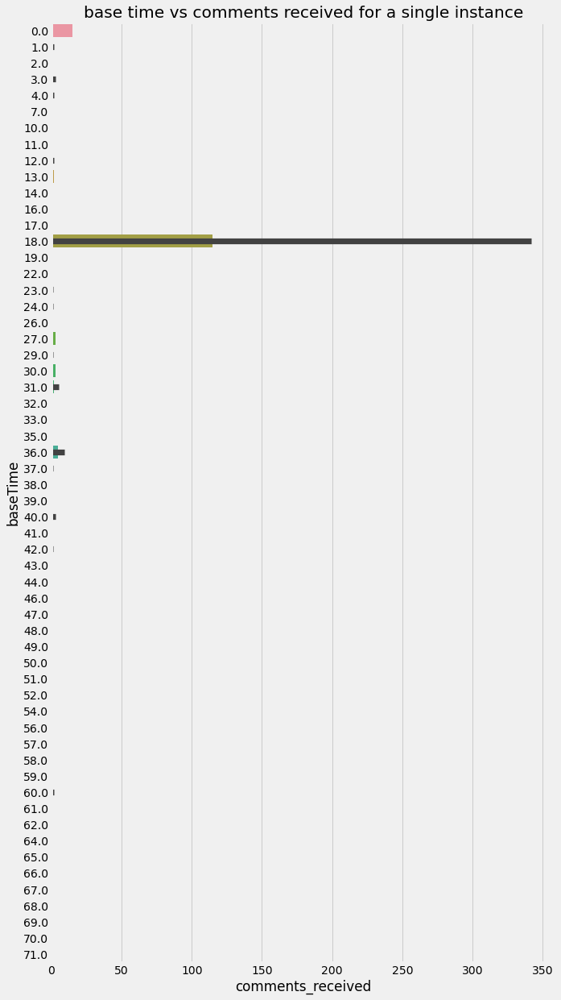

In [16]:
plot_hist_horizontal('comments_received','baseTime', 
                     data = data[(data.pg_likes == 634995) & ( data.c1_std_dev == 70.49510000)],
                    title = 'base time vs comments received for a single instance')

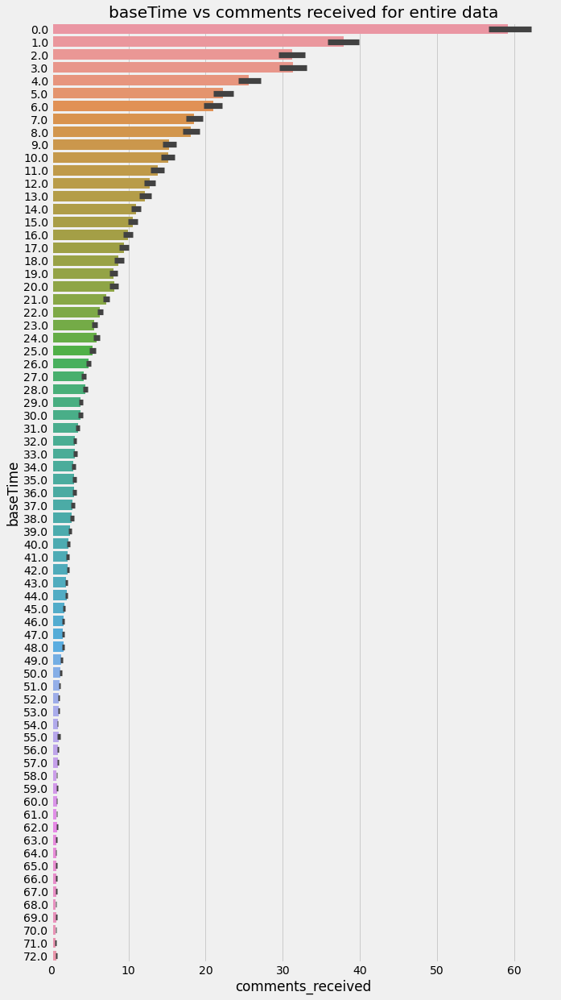

In [17]:
plot_hist_horizontal('comments_received','baseTime', data = data, title = 'baseTime vs comments received for entire data')

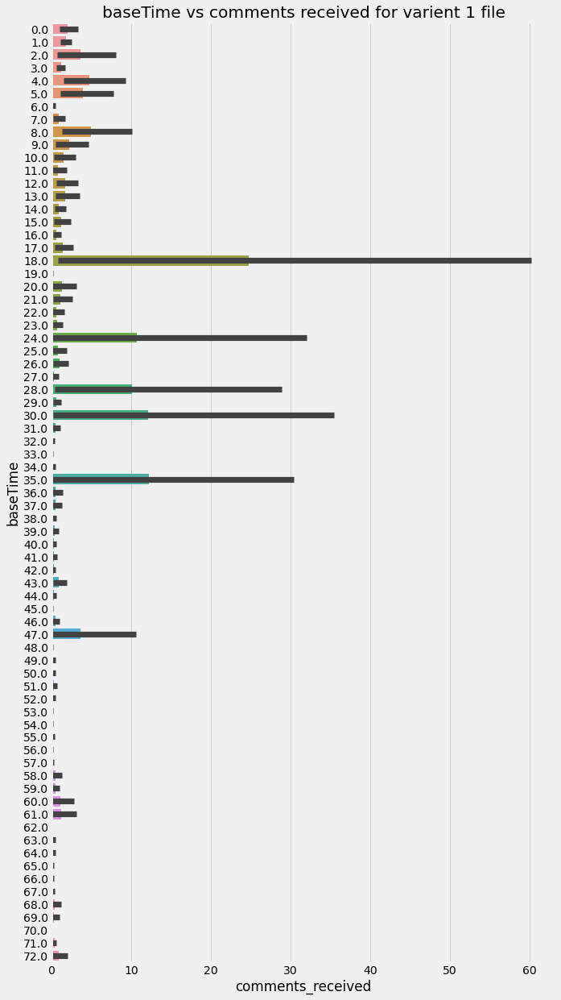

In [18]:
plot_hist_horizontal('comments_received','baseTime', data = data[data.pg_likes == 634995], 
                     title = 'baseTime vs comments received for varient 1 file')

Text(0.5, 1.0, 'Count plot for base time of data with 0 comments received')

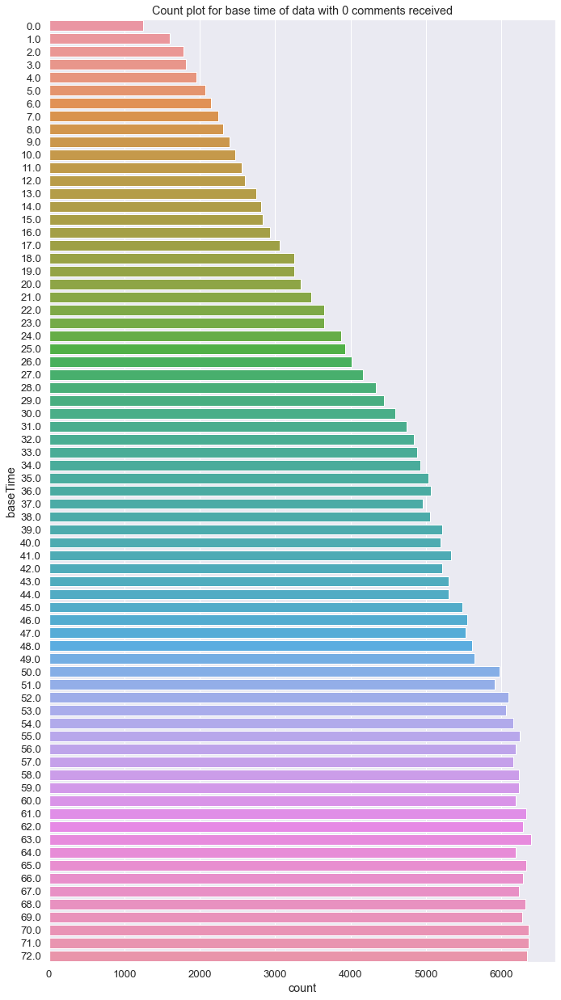

In [21]:
sns.set(font_scale = 1.2)
fig, ax = plt.subplots(figsize = (10,20))
sns.countplot(y = 'baseTime',data = data[data.comments_received == 0]  ,ax = ax, orient = 'h')
plt.title("Count plot for base time of data with 0 comments received")

- We can see that, higher base times has lower values of comments received, this might be because of lower popularity of post
as time passes.

- Also , data with 0 comments received has greater base times , summing to 3 lac records..
- So, since the 3 lac records might contain the same information ,it is better to remove some of these random samples from this category.

<h3>Analysing comments_received feature</h3>

In [159]:
def plot_distribution(feature, bins, title, df ):
    fig = px.histogram(df, x= feature, nbins = bins, title = title)
    fig.show()

def plot_distribution_bin_cntrl(start, end, size,data):
    start, end, size = str(start), str(end), str(size)
    fig = make_subplots(rows=1, cols=1)
    trace = go.Histogram(x=data,text = 'sdfsdf',
                          xbins=dict(
                          start=start,
                          end=end,
                          size=size), 
                          autobinx=False
                          )
    fig.append_trace(trace, 1,1)
    fig.show()

In [39]:
plot_distribution('comments_received', 30, 'Distribution of comments received for train data', data)

In [36]:
print('no of records with comments greater than 200: {}'.format(data[data.comments_received>200].shape[0]))

no of records with comments greater than 200: 3022


- About 98% of comments_received are less than 100
- Before handling the outliers of this category, we need to analyse the test set also.

In [160]:
plot_distribution_bin_cntrl(0,10,1,data.comments_received)

- Lets, analyse the comments_received columns in terms of percentagem

In [146]:
def plot_converted_to_categories(cmnts,bins,labels,title):
    mod = pd.cut(cmnts , bins =bins , labels =labels)
    d = mod.value_counts() *100 / mod.value_counts().sum()
    fig = px.bar(d, title = title)
    fig.show()
    

In [150]:
plot_converted_to_categories(data.comments_received
                             , [-1,0,data.comments_received.max()], [0,1], 'Distribution With 2 categories')

__0- 0<br>greater than 0- 1__

In [152]:
plot_converted_to_categories(data.comments_received,
                             [-.5, 0 ,2,10,data.comments_received.max()], [0,1,2,3], 'Distribution with 4 categories' )

                                   
<table>
    <tr>
        <th>Count of Comment_received</th>
        <th>Label Assigned</th>
        <th>Percentage of records</th>
        <th>Actual Count</th>
    </tr>
    <tr>
        <td>0</td>
        <td>0</td>
        <td>55</td>
        <td>331 k</td>
    </tr>
    <tr>
        <td>1,2</td>
        <td>1</td>
        <td>19</td>
        <td>114 k</td>
    </tr>
    <tr>
        <td>3 to 10</td>
        <td>2</td>
        <td>14</td>
        <td>84 k </td>
    </tr>
    <tr>
        <td>10+</td>
        <td>3</td>
        <td>11</td>
        <td>66 k</td>
    </tr>
      

</table>

__Based on the analysis of the target variable, it seems reasonable to model this as a classification problem with post_status 
as the target variable__ 
<table>
    <tr>
        <th>Label</th>
        <th>Staus of post</th>
    </tr>
    <tr>
        <td>0</td>
        <td>Inactive</td>
    </tr>
    <tr>
        <td>1</td>
        <td>Not Active</td>
    </tr>
    <tr>
        <td>2</td>
        <td>Moderately Active</td>
    </tr>
     <tr>
        <td>3</td>
        <td>Active</td>
    </tr>
        
        
</table>

In [168]:
#Adding the new label column
data['post_status'] = pd.cut(data.comments_received, bins = [-.5, 0 ,2,10,data.comments_received.max()],labels =  [0,1,2,3])

<h3>Analysing Page Category Feature </h3>

In [85]:
data.pg_category.value_counts()

9.0     110313
24.0     66473
18.0     63314
36.0     35163
16.0     27805
         ...  
62.0       232
63.0        58
58.0        29
93.0        15
83.0        15
Name: pg_category, Length: 81, dtype: int64

<AxesSubplot:xlabel='count', ylabel='pg_category'>

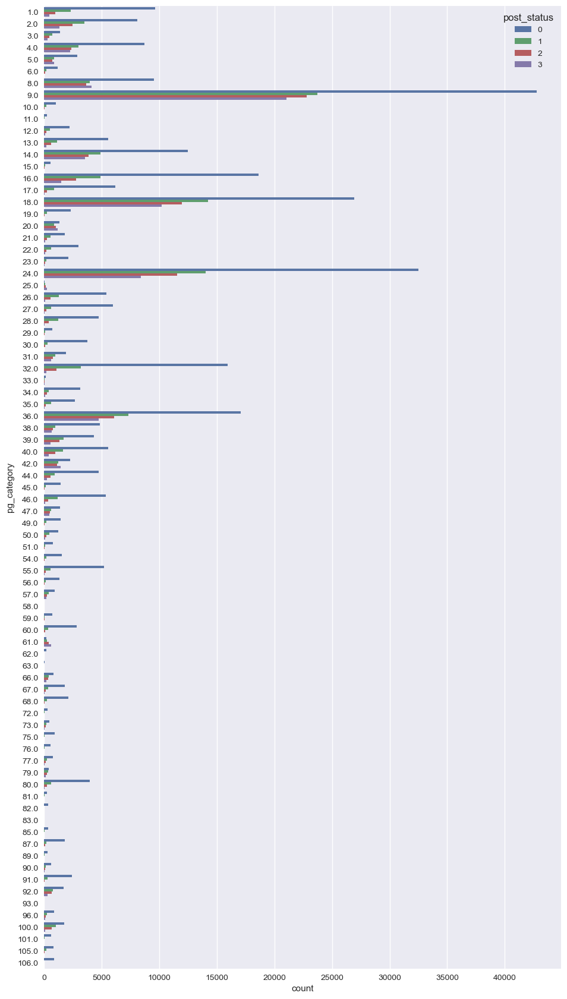

In [226]:
plt.figure(figsize = (10,20))
sns.countplot(y = 'pg_category', hue = 'post_status', data = data , orient = 'h')

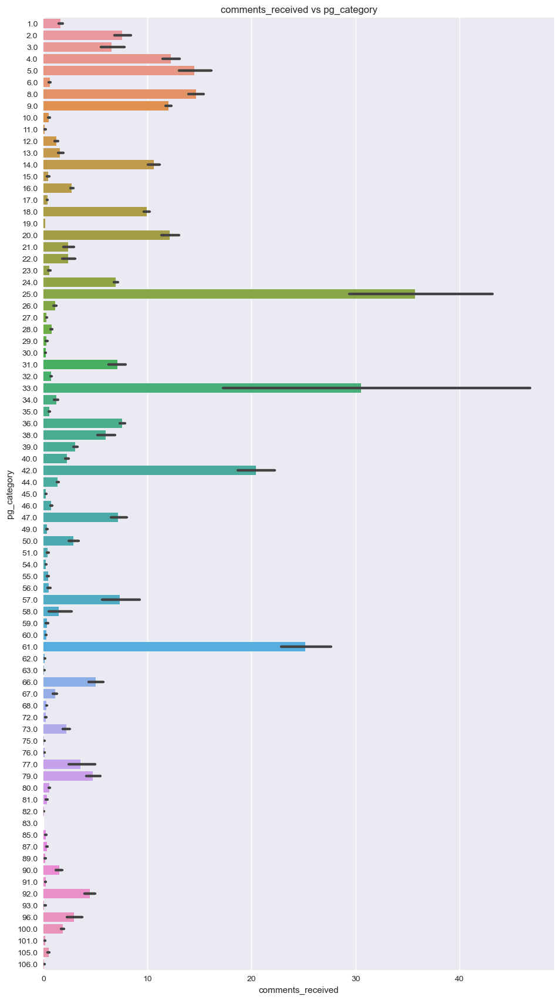

In [163]:
plot_hist_horizontal('comments_received','pg_category', 
                     data = data ,
                    title = 'comments_received vs pg_category')

__Frequency of page category has nothing to do with comments_received__

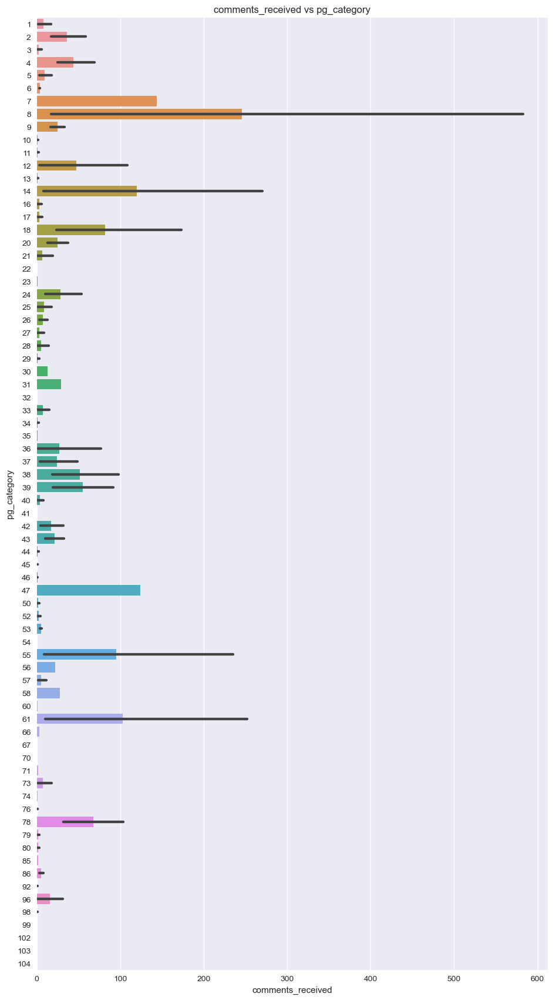

In [164]:
plot_hist_horizontal('comments_received','pg_category', 
                     data = train_1 ,
                    title = 'comments_received vs pg_category')

In [184]:
data[data.post_status==3]['pg_category'].nunique()

63

In [190]:
data.columns

Index(['pg_likes', 'pg_checkins', 'people_returns_pg', 'pg_category', 'c1_min',
       'c1_max', 'c1_avg', 'c1_median', 'c1_std_dev', 'c2_min', 'c2_max',
       'c2_avg', 'c2_median', 'c2_std_dev', 'c3_min', 'c3_max', 'c3_avg',
       'c3_median', 'c3_std_dev', 'c4_min', 'c4_max', 'c4_avg', 'c4_median',
       'c4_std_dev', 'c5_min', 'c5_max', 'c5_avg', 'c5_median', 'c5_std_dev',
       'c1', 'c2', 'c3', 'c4', 'c5', 'baseTime', 'post_length', 'post_shares',
       'post_promotion_status', 'hrs', 'post_pub_sun', 'post_pub_mon',
       'post_pub_tue', 'post_pub_wed', 'post_pub_thu', 'post_pub_fri',
       'post_pub_sat', 'base_sun', 'base_mon', 'base_tue', 'base_wed',
       'base_thu', 'base_fri', 'base_sat', 'comments_received', 'post_status'],
      dtype='object')

<AxesSubplot:>

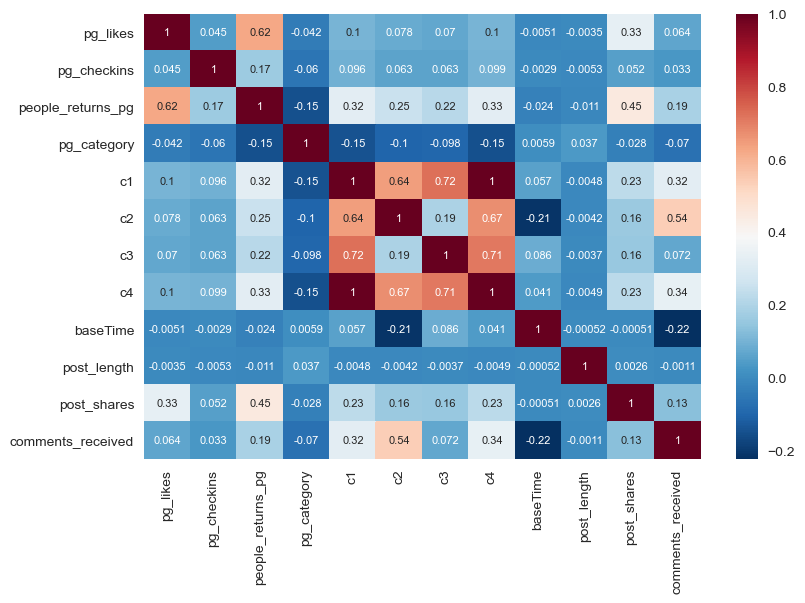

In [206]:
cols = ['pg_likes', 'pg_checkins', 'people_returns_pg', 'pg_category',
        'c1', 'c2', 'c3', 'c4', 'baseTime', 'post_length', 'post_shares','comments_received']

sns.heatmap(data[cols].corr(), cmap =plt.colormaps()[45], annot = True, annot_kws={'size':8})

__It can be seen from the plot that c1, c2, c3 and c4 and highly correlated, so  feature transformation needs to be done:-__
 - c1 and c4 have very high correlation, so c4 is droped
 - Dependding on the correlation with target a new feature is developed 

In [218]:
data['c_trans'] = (1.5*data.c1 + 2*data.c2 + data.c3)/3

<AxesSubplot:>

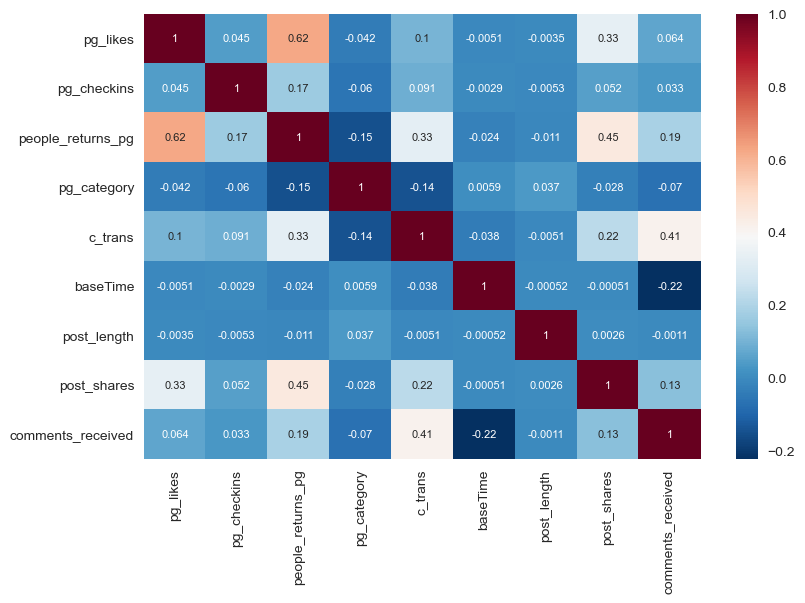

In [220]:
cols = ['pg_likes', 'pg_checkins', 'people_returns_pg', 'pg_category',
        'c_trans', 'baseTime', 'post_length', 'post_shares','comments_received']

sns.heatmap(data[cols].corr(), cmap =plt.colormaps()[45], annot = True, annot_kws={'size':8})

<h3>Analysing hours</h3>

<AxesSubplot:xlabel='hrs', ylabel='count'>

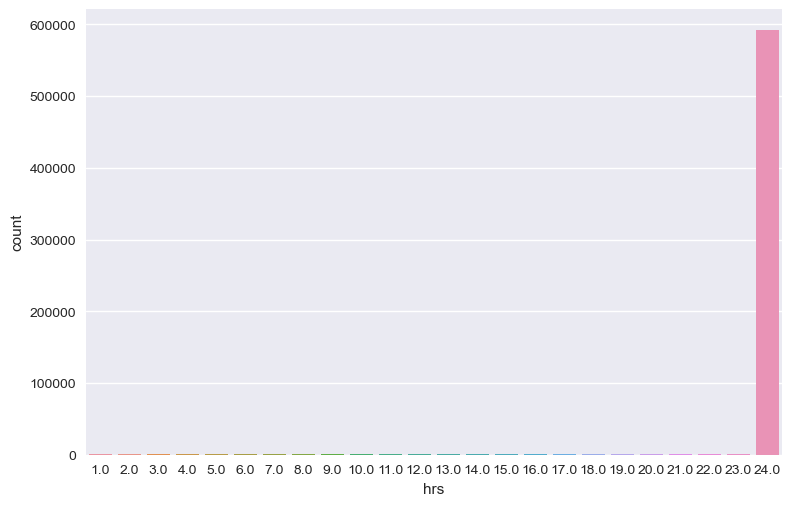

In [232]:
sns.countplot(data.hrs)

<AxesSubplot:xlabel='hrs', ylabel='count'>

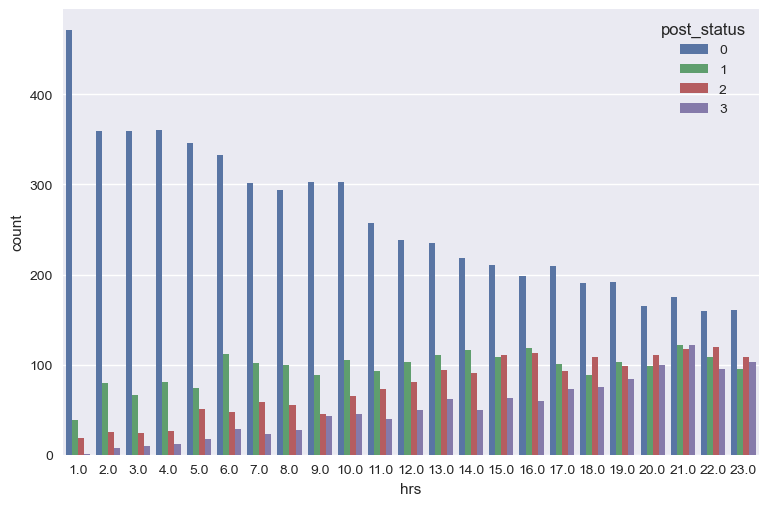

In [234]:
sns.countplot(x = 'hrs', hue = 'post_status',data = data[data.hrs!=24])

<h2>Analysing the Test set </h2>

In [27]:
#reading train data
files = os.listdir('Raw_Data_Prediction')

train_1 = pd.DataFrame()


for file in files:
    if file[0] != 'F':
        d = pd.read_csv('Raw_Data_Prediction/'+ file, header = None)
        train_1 = train_1.append(d ,ignore_index = True)
        
train_1.rename(columns = dict(zip(range(0,54), data.columns)), inplace = True)

In [28]:
#other train files       
 
train_2 = pd.DataFrame()

for file in files:
    d = pd.read_csv('Raw_Data_Prediction/'+ file, header = None)
    train_2 = train_2.append(d ,ignore_index = True)
    break
    
train_2.rename(columns = dict(zip(range(0,54), data.columns)), inplace = True)

In [24]:
def create_profile_report(data, file_name , target_feat = 'comments_received'):
    my_report = sweetviz.analyze([data, file_name.split('.')[0]], target_feat = target_feat)
    my_report.show_html(file_name)

In [25]:
#obtain profile report of training bathes
create_profile_report(train_1, 'test_batch_1.html', 'comments_received')
create_profile_report(train_2, 'test_batch_2.html', 'comments_received')

:FEATURES DONE:                    |█████████████████████| [100%]   01:25  -> (00:00 left)
:PAIRWISE DONE:                    |█████████████████████| [100%]   00:01  -> (00:00 left)


Creating Associations graph... DONE!
Report test_batch_1.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


:FEATURES DONE:                    |█████████████████████| [100%]   02:05  -> (00:00 left)
:PAIRWISE DONE:                    |█████████████████████| [100%]   00:14  -> (00:00 left)


Creating Associations graph... DONE!
Report test_batch_2.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


<h3>Analysing the baseTime</h3>

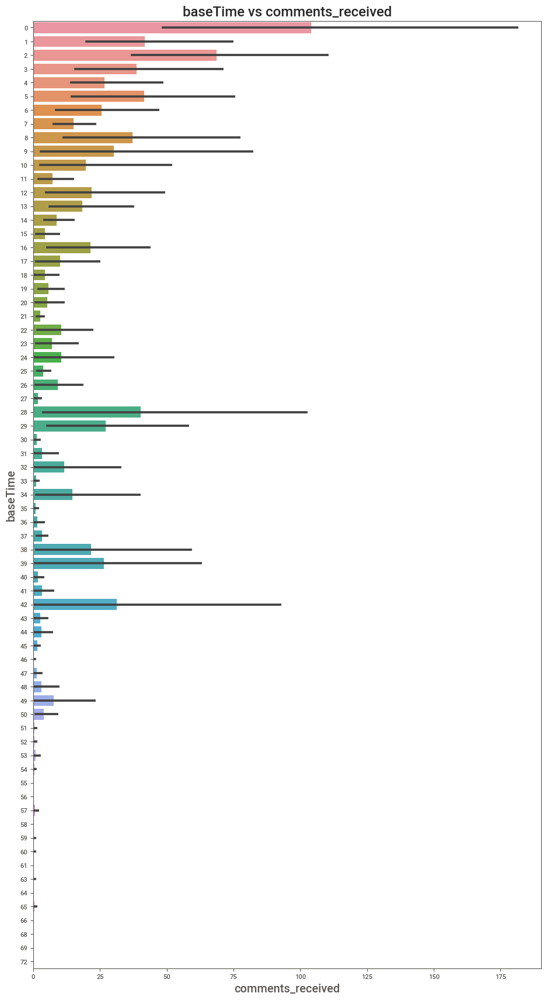

In [29]:
plot_hist_horizontal('comments_received', 'baseTime', train_1, 'baseTime vs comments_received')

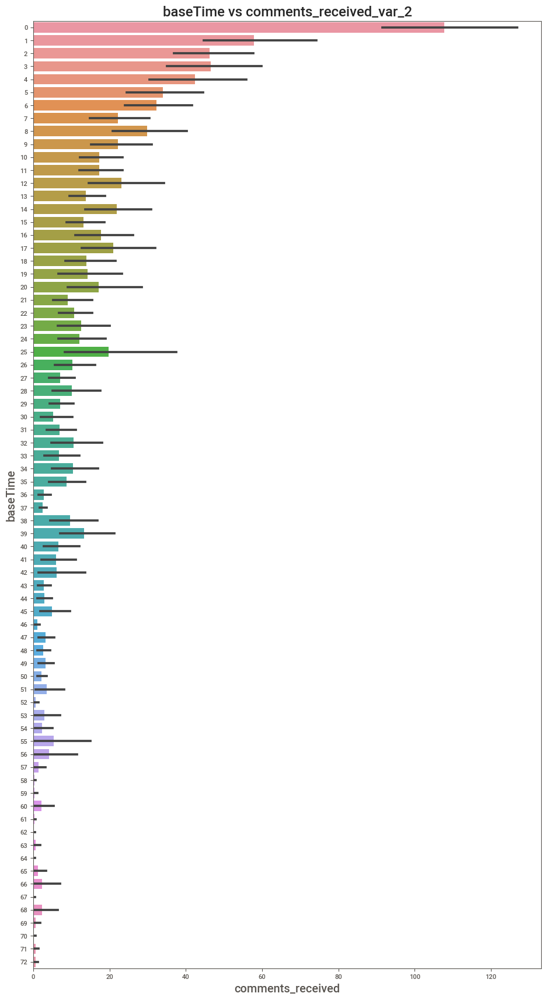

In [30]:
plot_hist_horizontal('comments_received', 'baseTime', train_2, 'baseTime vs comments_received_var_2')

- A patter similar to test set is obtained for baseTime in test set also

<h3>Analysing the comments_received</h3>

In [41]:
plot_distribution('comments_received', 30,'comments_received distribution of train_set_1', train_1)

In [42]:
plot_distribution('comments_received', 30,'comments_received distribution of train_set_2', train_2)

__Distribution between 0 and 10__

In [161]:
plot_distribution_bin_cntrl(0,10,1,train_1.comments_received)

In [162]:
plot_distribution_bin_cntrl(0,10,1,train_2.comments_received)

In [154]:
plot_converted_to_categories(train_1.comments_received, [-.5, 0 ,2,10,data.comments_received.max()], [0,1,2,3],
                             'Distribution with 4 categories train_set' )

In [155]:
plot_converted_to_categories(train_2.comments_received, [-.5, 0 ,2,10,data.comments_received.max()], [0,1,2,3],
                             'Distribution with 4 categories train_set_2' )